In [1]:
#importing packages
import copy
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import pickle
%matplotlib inline

# Provide an example of a distortion-corrected image.

In [2]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
chess_board_size = (9,6)
objp = np.zeros((chess_board_size[0]*chess_board_size[1],3), np.float32)
objp[:,:2] = np.mgrid[0:chess_board_size[0], 0:chess_board_size[1]].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for idx, fname in enumerate(images):
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, chess_board_size, None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        cv2.drawChessboardCorners(img, chess_board_size, corners, ret)
        cv2.imshow('img', img)
        cv2.waitKey(100)

cv2.destroyAllWindows()
print('finish checker detection')

finish checker detection


In [3]:
# camera calibration
img = cv2.imread('test_images/test2.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "calibration_data.p", "wb" ) )

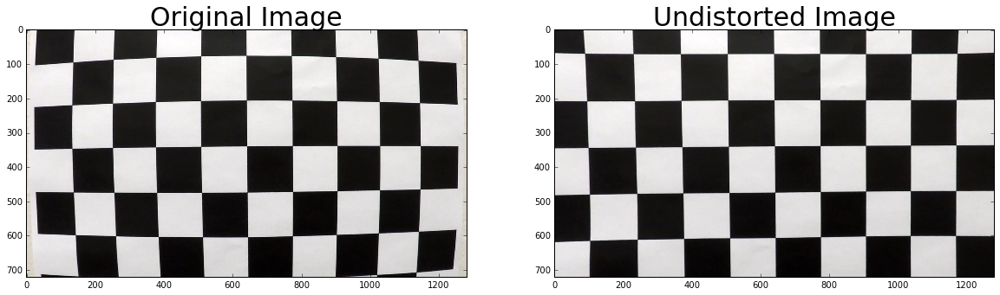

In [4]:
# test on the calibration image
img = cv2.imread('camera_cal/calibration1.jpg')
dst = cv2.undistort(img, mtx, dist, None, mtx)

# BGR to RGB for visualization by matplotlib
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)

f, axs = plt.subplots(1, 2, figsize=(20,10))
axs[0].imshow(img)
axs[1].imshow(dst)
axs[0].set_title('Original Image', fontsize=30)
axs[1].set_title('Undistorted Image', fontsize=30)

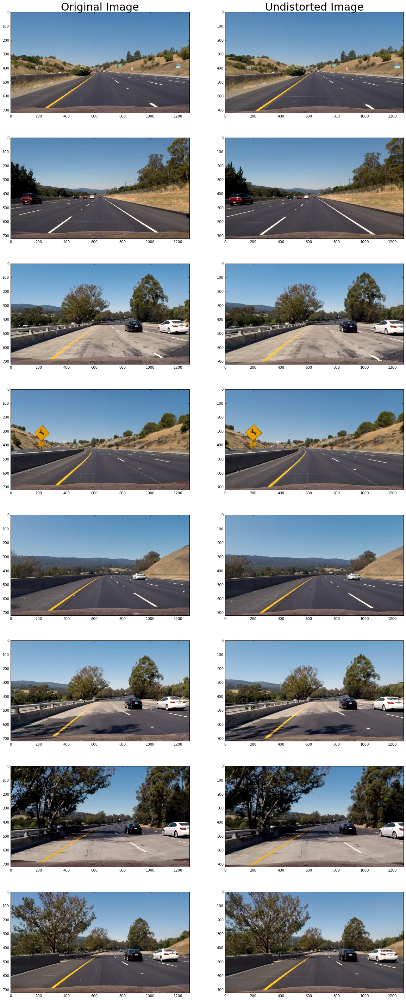

In [13]:
# image undistortion function
with open('calibration_data.p','rb') as f:
    data = pickle.load(f)

mtx = data['mtx']
dist = data['dist']
test_images = glob.glob('test_images/*')
images = []
dst_images = []

def undist_image(image):
     return cv2.undistort(image, mtx, dist, None, mtx)
    
# Test undistortion on an image
for i, image in enumerate(test_images):
    img = cv2.imread(image)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    
    # Save result image
    cv2.imwrite('writeup_images/test_image_'+str(i)+'.jpg', dst)
    
    # BGR to RGB for visualization by matplotlib
    dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    images.append(img)
    dst_images.append(copy.deepcopy(dst))
    
# Visualize undistortion
f, axs = plt.subplots(len(test_images), 2, figsize=(20,50))
for i in range(len(test_images)):
    axs[i, 0].imshow(images[i])
    axs[i, 1].imshow(dst_images[i])
    if i == 0:
        axs[i, 0].set_title('Original Image', fontsize=30)
        axs[i, 1].set_title('Undistorted Image', fontsize=30)

#  Describe how (and identify where in your code) you used color transforms, gradients or other methods to create a thresholded binary image. Provide an example of a binary image result.

(1280, 720)
[[  210.   720.]
 [  583.   460.]
 [  697.   460.]
 [ 1070.   720.]]
[[ 290.  720.]
 [ 290.    0.]
 [ 990.    0.]
 [ 990.  720.]]


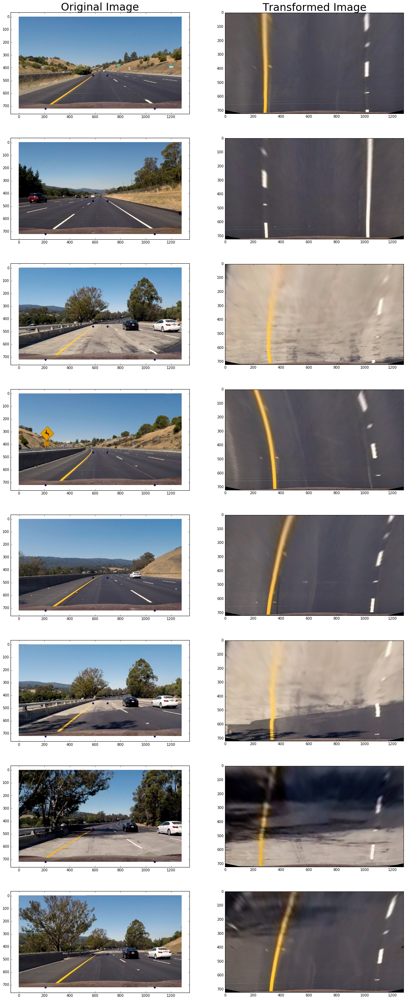

In [14]:
img_size = images[0].shape[1::-1]
print(img_size)
"""
src = np.float32([[230, 700],
                  [565, 470],
                  [725, 470],
                  [1100, 700]])
dst = np.float32([[300, 700],
                  [300, 50],
                  [1000, 50],
                  [1000, 700]])
"""
d0 = 430
d1 = 57
d2 = 100
d3 = 350
src = np.float32([[img_size[0]/2 - d0, img_size[1]],
                  [img_size[0]/2 - d1, img_size[1]/2 + d2],
                  [img_size[0]/2 + d1, img_size[1]/2 + d2],
                  [img_size[0]/2 + d0, img_size[1]]])
dst = np.float32([[img_size[0]/2 - d3, img_size[1]],
                  [img_size[0]/2 - d3, 0],
                  [img_size[0]/2 + d3, 0],
                  [img_size[0]/2 + d3, img_size[1]]])
print(src)
print(dst)


M = cv2.getPerspectiveTransform(src, dst)

def transform_image(image):
    warped = cv2.warpPerspective(image, M,  (image.shape[1], image.shape[0])) 
    return warped

def test(image):
    dst_img = undist_image(image)
    transformed_image = transform_image(dst_img)
    return transformed_image


# Test
test_images_path = glob.glob('test_images/*')
images = []
test_images = []
for i, image in enumerate(test_images_path):
    img = cv2.imread(image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    dst = test(img)
    
    # BGR to RGB for visualization by matplotlib
    images.append(copy.deepcopy(img))
    test_images.append(copy.deepcopy(dst))

f, axs = plt.subplots(len(test_images_path), 2, figsize=(20,50))
for i, image in enumerate(images):
    axs[i, 0].imshow(images[i])
    axs[i, 0].hold(True)
    axs[i, 0].scatter(x=src[:, 0], y=src[:, 1])
    axs[i, 1].imshow(test_images[i])
    if i == 0:
        axs[i, 0].set_title('Original Image', fontsize=30)
        axs[i, 1].set_title('Transformed Image', fontsize=30)

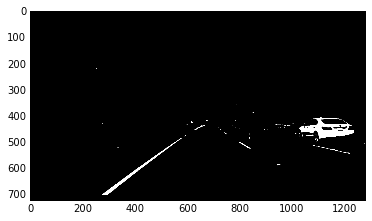

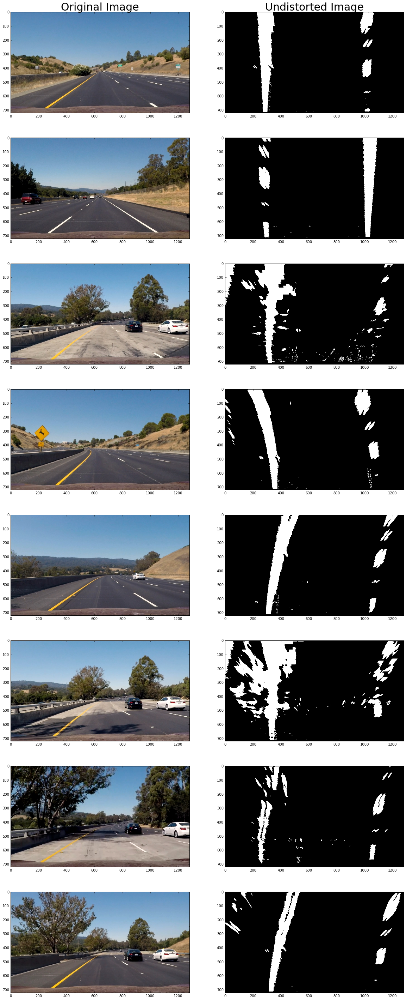

In [44]:
def hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # Get Saturation
    S = hls[:,:,2]
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    return binary, hls

def hsv_select(img, thresh=(0, 255)):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    # Get Value
    V = hsv[:,:,2]
    binary = np.zeros_like(V)
    binary[(V > thresh[0]) & (V <= thresh[1])] = 1
    return binary, hsv

def yellow_select(hue, thresh=(40, 100)):
    binary = np.zeros_like(hue)
    binary[(hue > thresh[0]) & (hue <= thresh[1])] = 1
    return binary

def red_select(img, thresh=(40, 100)):
    binary = np.zeros_like(img[:,:,0])
    binary[(img[:,:,0] > thresh[0]) & (img[:,:,0] <= thresh[1])] = 1
    return binary, img[:,:,0]

def luminance_select(hls_image, thresh=(0, 255)):
    # Get Luminance
    L = hls_image[:,:,1]
    binary = np.zeros_like(L)
    binary[(L > thresh[0]) & (L <= thresh[1])] = 1
    return binary
    
def abs_sobel_thresh(img, sobel_kernel=3, orient='x', thresh=(0, 255)):
    gray = img
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #gray = img
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output, red

def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = img
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def edge_threshold(img_gray, mag_thresh=(0, 255), thresh=(0, 255), ksize=5):
    # Gaussian blur
    img_blur = gaussian_blur(img=img_gray, kernel_size=ksize)
    # Canny filter
    img_edge = canny(img=img_blur, low_threshold=thresh[0], high_threshold=thresh[1])
    #plt.imshow(img_edge, cmap='gray')
    binary_output = np.zeros_like(img_edge)
    binary_output[(img_edge >= mag_thresh[0]) & (img_edge <= mag_thresh[1])] = 1
    return binary_output

############################
# Main process in this cell
############################
def get_threshold_binary_image(image):
    # Choose a Sobel kernel size
    ksize = 9 # Choose a larger odd number to smooth gradient measurements

    # Filtering Operations
    value_binary, hsv = hsv_select(image, thresh=(220, 255))
    value = hsv[:,:,2]
        
    gradx = abs_sobel_thresh(value, orient='x', sobel_kernel=ksize, thresh=(20, 255))
    direction = 0
    dir_binary = dir_threshold(value, sobel_kernel=ksize, thresh=(direction - 0.03, direction + 0.03))
    red_binary, red = red_select(image, thresh=(210, 255))
    
    # Binary images
    combined = np.zeros_like(value)
    combined[(value_binary == 1) |  (red_binary == 1)  | ((dir_binary == 0) & (gradx == 1)) ] = 1
    return combined, red_binary

# ROI  filtering used in Project 1
def region_of_interest(img):
    # Region Mask
    imshape = img.shape
    vertices = np.array([[(220, 700), (575, 400), (685, 400), (1100, 700)]], dtype=np.int32)
    
    mask = np.zeros_like(img)   
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def test(image):
    dst_img = undist_image(image)
    binary_img, im_ = get_threshold_binary_image(dst_img)
    binary_img = region_of_interest(binary_img)
    output = transform_image(binary_img)
    #plt.imshow(binary_img, cmap='gray')
    plt.imshow(im_, cmap='gray')
    return output

# Test
test_images_path = glob.glob('test_images/*')
images = []
test_images = []
for i, image in enumerate(test_images_path):
    if i < len(test_images_path):
        img = cv2.imread(image)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        dst = test(img)

        # BGR to RGB for visualization by matplotlib
        images.append(copy.deepcopy(img))
        test_images.append(copy.deepcopy(dst))

f, axs = plt.subplots(len(test_images_path), 2, figsize=(20,50))
for i, image in enumerate(images):
    axs[i, 0].imshow(images[i])
    axs[i, 1].imshow(test_images[i], cmap='gray')
    if i == 0:
        axs[i, 0].set_title('Original Image', fontsize=30)
        axs[i, 1].set_title('Undistorted Image', fontsize=30)

#  Describe how (and identify where in your code) you performed a perspective transform and provide an example of a transformed image.

# Describe how (and identify where in your code) you identified lane-line pixels and fit their positions with a polynomial?

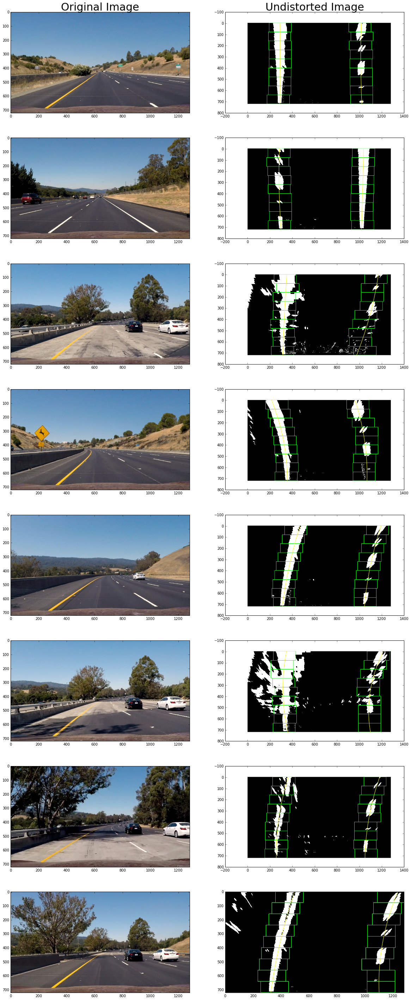

In [45]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def line_finder(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    return (left_fitx, right_fitx, ploty), (left_fit, right_fit), out_img, (left_lane_inds, right_lane_inds)


def test(image):
    dst_img = undist_image(image)
    binary_img, saturation = get_threshold_binary_image(dst_img)
    binary_img = region_of_interest(binary_img)
    binary_warped = transform_image(binary_img)
    (left_fitx, right_fitx, ploty), (left_fit, right_fit), out_img, (left_lane_inds, right_lane_inds) = line_finder(binary_warped)
    return out_img, (left_fitx, right_fitx, ploty)

# Test
test_images_path = glob.glob('test_images/*')
images = []
test_images = []
result_plot = []
for i, image in enumerate(test_images_path):
    img = cv2.imread(image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    dst, (left_fitx, right_fitx, ploty) = test(img)
    
    # BGR to RGB for visualization by matplotlib
    images.append(copy.deepcopy(img))
    test_images.append(copy.deepcopy(dst))
    result_plot.append((left_fitx, right_fitx, ploty))

f, axs = plt.subplots(len(test_images_path), 2, figsize=(20,50))
for i, image in enumerate(images):
    (left_fitx, right_fitx, ploty) = result_plot[i]
    axs[i, 0].imshow(images[i])
    axs[i, 1].imshow(test_images[i], cmap='gray')
    axs[i, 1].plot(left_fitx, ploty, color='yellow')
    axs[i, 1].plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    plt.draw()
    if i == 0:
        axs[i, 0].set_title('Original Image', fontsize=30)
        axs[i, 1].set_title('Undistorted Image', fontsize=30)

In [46]:
def get_curvature(left_fitx, right_fitx, ploty):
    # Define conversions in x and y from pixels space to meters
    y_eval = np.max(ploty)
    ym_per_pix = 30/720. # meters per pixel in y dimension
    xm_per_pix = 3.7/700. # meters per pixel in x dimension
    
    # center point of the observaed lines [m]
    center_x = 0.5*(left_fitx[0]*xm_per_pix + right_fitx[0]*xm_per_pix)
    center_diff = center_x - 0.5*img_size[0]*xm_per_pix

    # Fit new polynomials to x,y in world space
    left_fit_world = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_world = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    left_curverad = ((1 + (2*left_fit_world[0]*y_eval*ym_per_pix + left_fit_world[1])**2)**1.5) / np.absolute(2*left_fit_world[0])
    right_curverad = ((1 + (2*right_fit_world[0]*y_eval*ym_per_pix + right_fit_world[1])**2)**1.5) / np.absolute(2*right_fit_world[0])
    
    mean_curvature = (left_curverad + right_curverad)/2.
    return mean_curvature, center_diff

def find_lines(binary_warped):
    (left_fitx, right_fitx, ploty), (left_fit, right_fit), out_img, (left_lane_inds, right_lane_inds) = line_finder(binary_warped)
    curvature, center_diff = get_curvature(left_fitx, right_fitx, ploty)
    return (left_fitx, right_fitx, ploty), curvature, (left_fit, right_fit), center_diff

def test(image):
    dst_img = undist_image(image)
    binary_img, saturation = get_threshold_binary_image(dst_img)
    binary_img = region_of_interest(binary_img)
    #binary_img_roi = region_of_interest(binary_img)
    transformed_image = transform_image(binary_img)
    (left_fitx, right_fitx, ploty), curvature, (left_fit, right_fit), center_diff = find_lines(transformed_image)
    return (left_fitx, right_fitx, ploty), curvature, (left_fit, right_fit), center_diff


for i, image in enumerate(test_images_path):
    img = cv2.imread(image)
    line_fit_result, curvature, (left_fit, right_fit), center_diff = test(img)
    
    print('{:.1f} m (Curvature Radius)'.format(curvature))
    if center_diff > 0.0:
        print('{:.3f} m Left'.format(np.abs(center_diff)))
    elif center_diff < -0.0:
        print('{:.3f} m Right'.format(np.abs(center_diff)))
    if np.abs(center_diff) < 0.3:
        print('Almost Center')

9591.3 m (Curvature Radius)
0.069 m Left
Almost Center
11122.8 m (Curvature Radius)
0.113 m Left
Almost Center
1484.0 m (Curvature Radius)
0.680 m Left
627.1 m (Curvature Radius)
0.275 m Right
Almost Center
1086.0 m (Curvature Radius)
1.010 m Left
702.9 m (Curvature Radius)
0.786 m Left
726.5 m (Curvature Radius)
0.696 m Left
848.1 m (Curvature Radius)
1.188 m Left


# Provide an example image of your result plotted back down onto the road such that the lane area is identified clearly.

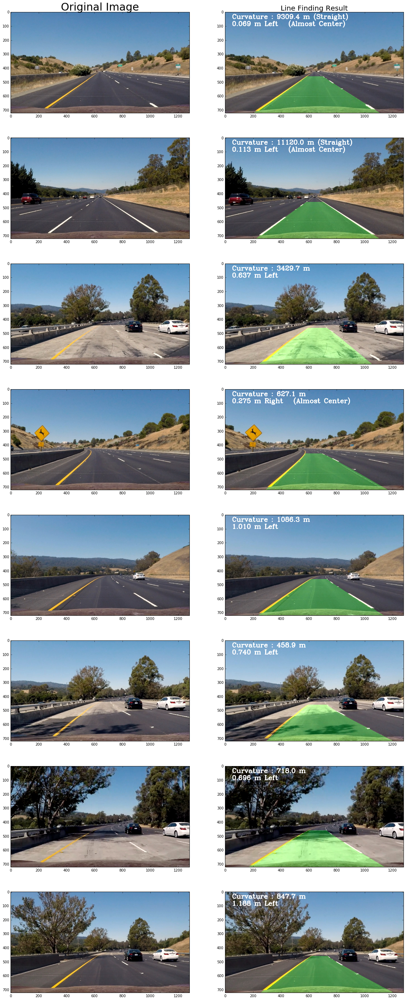

In [47]:

def get_lane_area_image(undst_image, line_fit_result, curvature, center_diff):
    # Create an image to draw the lines on
    #print(undst_image.shape)
    color_warp =np.zeros_like(undst_image, dtype=np.uint8)
    left_fitx, right_fitx, ploty = line_fit_result
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    #print(undist_image)
    newwarp = cv2.warpPerspective(color_warp, np.linalg.pinv(M), (undst_image.shape[1], undst_image.shape[0])) 
    # Combine the result with the original image
    output = cv2.addWeighted(undst_image, 1, newwarp, 0.3, 0)
    
    #  Show the curvature Information and the drift from the center lane
    if curvature > 5000:
        text = "Curvature : {:.1f} m (Straight)".format(curvature)
    else:
        text = "Curvature : {:.1f} m".format(curvature)
    cv2.putText(output ,text, (50, 50), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255, 255, 255), 3, cv2.CV_AA)
    
    if center_diff > 0.0:
        text = '{:.3f} m Left'.format(np.abs(center_diff))
    elif center_diff < -0.0:
        text = '{:.3f} m Right'.format(np.abs(center_diff))
    if np.abs(center_diff) < 0.3:
        text += '   (Almost Center)'
    cv2.putText(output ,text, (50, 100), cv2.FONT_HERSHEY_COMPLEX, 1.5, (255, 255, 255), 3, cv2.CV_AA)
    return output

def test(image):
    dst_img = undist_image(image)
    binary_img, saturation = get_threshold_binary_image(dst_img)
    binary_img = region_of_interest(binary_img)
    transformed_image = transform_image(binary_img)
    line_fit_result, curvature, (left_fit, right_fit), center_diff = find_lines(transformed_image)
    
    # Get the result image
    lane_area_image = get_lane_area_image(dst_img, line_fit_result, curvature, center_diff)
    return lane_area_image


# Test
test_images_path = glob.glob('test_images/*')
images = []
results = []
for path in test_images_path:
    img = cv2.imread(path)
    # BGR to RGB for visualization by matplotlib
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    result = test(img)
    
    images.append(img)
    results.append(copy.deepcopy(result))

# Show Test Result
f, axs = plt.subplots(len(test_images_path), 2, figsize=(20,50))
for i, image in enumerate(test_images_path):
    axs[i, 0].imshow(images[i])
    axs[i, 1].imshow(results[i])
    
    if i == 0:
        axs[i, 0].set_title('Original Image', fontsize=30)
        axs[i, 1].set_title('Line Finding Result', fontsize=20)

In [48]:
#  Liner finder when the previous result is available
def find_next_lines(fit_result, binary_warped_next):
    left_fit, right_fit = fit_result
    
    nonzero = binary_warped_next.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped_next.shape[0]-1, binary_warped_next.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    curvature, center_diff = get_curvature(left_fitx, right_fitx, ploty)
    return (left_fitx, right_fitx, ploty), curvature, (left_fit, right_fit), center_diff

# Provide a link to your final video output. Your pipeline should perform reasonably well on the entire project video (wobbly lines are ok but no catastrophic failures that would cause the car to drive off the road!)

In [49]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

def line_finder_process(image, prev_line_fit=None):
    dst_img = undist_image(image)
    binary_img, saturation = get_threshold_binary_image(dst_img)
    binary_img_roi = region_of_interest(binary_img)
    transformed_image = transform_image(binary_img_roi)
    if prev_line_fit is None:
        line_fit_result, curvature, fit_result, center_diff = find_lines(transformed_image)
    else:
        #line_fit_result, curvature, fit_result = find_lines(transformed_image)
        line_fit_result, curvature, fit_result, center_diff = find_next_lines(prev_line_fit, transformed_image)
    lane_area_image = get_lane_area_image(dst_img, line_fit_result, curvature, center_diff)
    return lane_area_image, fit_result

#def process_image(image):
#    result = line_finder_process(image)
#    return result

class LineFinder(object):
    def __init__(self):
        self.prev_line_fit = None
        self.average_image = None
        self.alpha = 0.3
        
    def process_image(self, image):
        if self.average_image is None:
            self.average_image = image
        else:
            self.average_image = self.alpha*self.average_image + (1.0 - self.alpha)*image

        lane_area_image, fit_result = line_finder_process(image, self.prev_line_fit)
        self.prev_line_fit = fit_result
        return lane_area_image

In [50]:
lfp = LineFinder()

white_output = 'project_result.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(lfp.process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video project_result.mp4
[MoviePy] Writing video project_result.mp4


100%|█████████▉| 1260/1261 [06:35<00:00,  3.40it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_result.mp4 

CPU times: user 5min 32s, sys: 1min 58s, total: 7min 31s
Wall time: 6min 37s


In [51]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(white_output))

## For a standout submission, students should follow the suggestion in the lesson to not just search blindly for the lane lines in each frame of video, but rather, once they have a high-confidence detection, use that to inform the search for the position of the lines in subsequent frames of video. For example, if a polynomial fit was found to be robust in the previous frame, then rather than search the entire next frame for the lines, just a window around the previous detection could be searched. This will improve speed and provide a more robust method for rejecting outliers.

## For an additional improvement students should implement outlier rejection and use a low-pass filter to smooth the lane detection over frames, meaning add each new detection to a weighted mean of the position of the lines to avoid jitter.

## For students who really want to go above and beyond, implement these methods on the challenge videos as well, or on your their own videos they've recorded themselves.